# Image processing classes

In [3]:
import cv2
import numpy as np
import os
import random
from pathlib import Path
from skimage.metrics import structural_similarity as ssim
import time
import matplotlib.pyplot as plt

# Конфигурационные параметры
DATASET_PATH = "blood"
OUTPUT_DIR = "synthetic_data"
TILE_SIZE = (64, 64)
CANVAS_SIZE = (512, 512)
CELL_COUNT = (3, 15)
NUM_IMAGES = 20  # Увеличено количество генерируемых изображений
BACKGROUND_RANGE = (180, 220)  # Диапазон для искусственного фона

# Инициализация путей
Path(OUTPUT_DIR).mkdir(exist_ok=True)

class BloodCellGenerator:
    def __init__(self):
        self.images_path = ""
        self.mask_path = ""
        self.cell_templates = self._load_images("patch*.png")[:5]
        self.background_templates = self._load_images("fon*.png")[:5]
        
        if not self.cell_templates or not self.background_templates:
            raise ValueError("Не найдены необходимые файлы в директории dataset")

    def _load_images(self, pattern):
        files = list(Path(DATASET_PATH).glob(pattern))
        return [cv2.imread(str(f)) for f in files if f.is_file()]

    def _generate_artificial_cell(self):
        size = random.randint(TILE_SIZE[0]//2, TILE_SIZE[0])
        cell = np.zeros((size, size, 3), dtype=np.uint8)
        color = tuple(random.randint(50, 200) for _ in range(3))
        cv2.circle(cell, (size//2, size//2), size//2, color, -1)
        return cv2.GaussianBlur(cell, (5,5), 0)

    def _create_composite_background(self):
        if random.random() < 0.5:  # 50% chance для искусственного фона
            bg_color = random.randint(*BACKGROUND_RANGE)
            background = np.full((*CANVAS_SIZE[::-1], 3), bg_color, dtype=np.uint8)
        else:
            background = self._generate_tiled_background()
        return cv2.medianBlur(background, 3)

    def _generate_tiled_background(self):
        canvas = np.zeros((*CANVAS_SIZE[::-1], 3), dtype=np.uint8)
        tiles_x = CANVAS_SIZE[0] // TILE_SIZE[0]
        tiles_y = CANVAS_SIZE[1] // TILE_SIZE[1]
        
        for y in range(tiles_y):
            for x in range(tiles_x):
                tile = random.choice(self.background_templates)
                tile = cv2.resize(tile, TILE_SIZE)
                y1, y2 = y*TILE_SIZE[1], (y+1)*TILE_SIZE[1]
                x1, x2 = x*TILE_SIZE[0], (x+1)*TILE_SIZE[0]
                canvas[y1:y2, x1:x2] = tile
        return canvas

    def _blend_cells(self, background):
        composite = background.copy()
        num_cells = random.randint(*CELL_COUNT)
        
        for _ in range(num_cells):
            if random.random() < 0.7:  # 70% chance использовать реальные клетки
                cell = random.choice(self.cell_templates)
            else:
                cell = self._generate_artificial_cell()
            
            cell = cv2.resize(cell, (random.randint(40,80),)*2)
            mask = 255 * np.ones(cell.shape[:2], dtype=np.uint8)
            pos = (random.randint(0, CANVAS_SIZE[0]-cell.shape[1]), 
                   random.randint(0, CANVAS_SIZE[1]-cell.shape[0]))
            center = (pos[0] + cell.shape[1]//2, pos[1] + cell.shape[0]//2)
            
            composite = cv2.seamlessClone(
                cell, composite, mask, center, cv2.NORMAL_CLONE)
        return composite

    def generate_sample(self):
        base = self._create_composite_background()
        clean_image = self._blend_cells(base)
        return clean_image

class NoiseProcessor:
    @staticmethod
    def apply_gaussian_noise(img, intensity=15):
        noise = np.random.normal(0, intensity, img.shape).astype(np.int16)
        return np.clip(img + noise, 0, 255).astype(np.uint8)

    @staticmethod
    def apply_uniform_noise(img, strength=25):
        return cv2.add(img, np.uint8(strength * np.random.rand(*img.shape)))

class RestorationMetrics:
    @staticmethod
    def calculate_mse(orig, processed):
        return np.mean((orig - processed) ** 2)

    @staticmethod
    def calculate_ssim(orig, processed):
        return ssim(orig, processed, multichannel=True, win_size=3,
                    channel_axis=2, data_range=255)

# Run proccessing

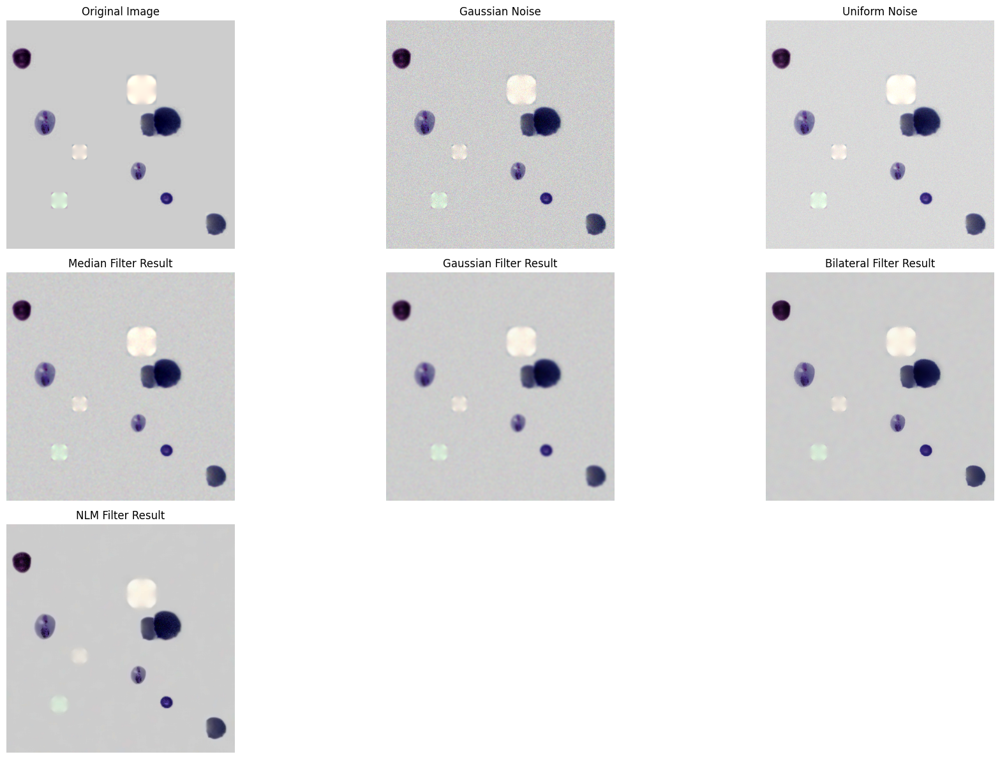


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0011 | 13.26 | 0.9183
Gaussian Blur        | 0.0003 | 8.30 | 0.9712
Bilateral Filter     | 0.0057 | 7.57 | 0.9349
Non-local Means      | 0.1397 | 5.21 | 0.9736


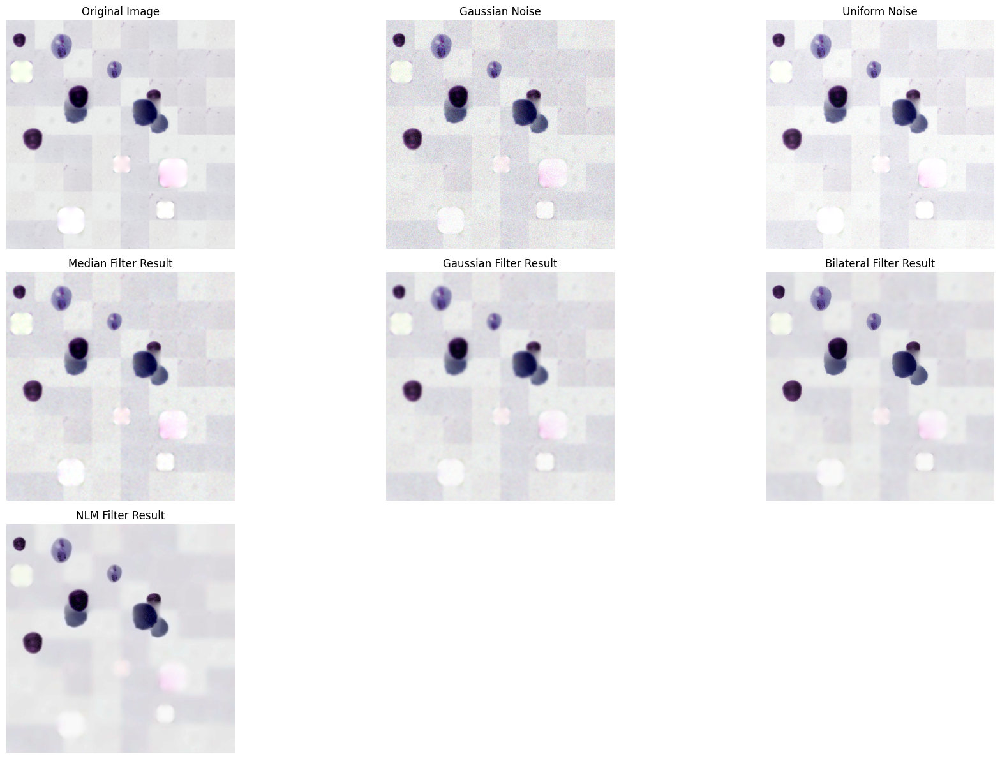


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0010 | 15.64 | 0.8990
Gaussian Blur        | 0.0005 | 12.07 | 0.9472
Bilateral Filter     | 0.0056 | 12.02 | 0.9175
Non-local Means      | 0.1454 | 13.93 | 0.9373


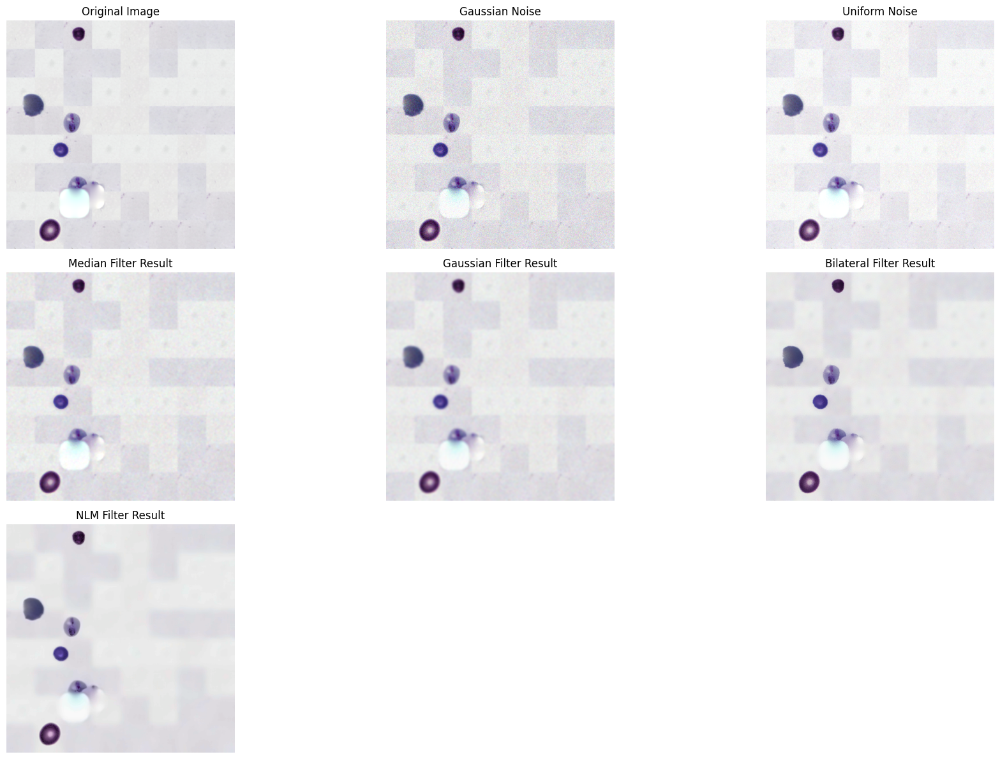


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0013 | 15.02 | 0.9024
Gaussian Blur        | 0.0007 | 9.97 | 0.9546
Bilateral Filter     | 0.0056 | 10.21 | 0.9232
Non-local Means      | 0.1516 | 10.95 | 0.9491


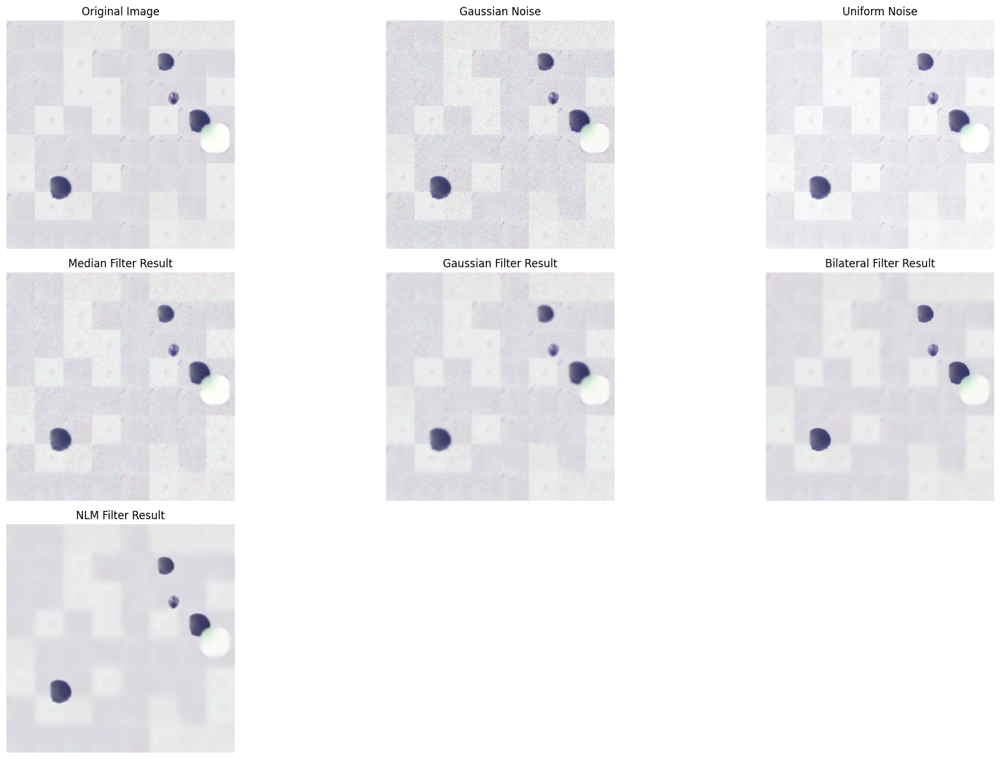


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0011 | 14.51 | 0.9031
Gaussian Blur        | 0.0007 | 8.92 | 0.9566
Bilateral Filter     | 0.0066 | 9.35 | 0.9238
Non-local Means      | 0.1481 | 10.22 | 0.9504


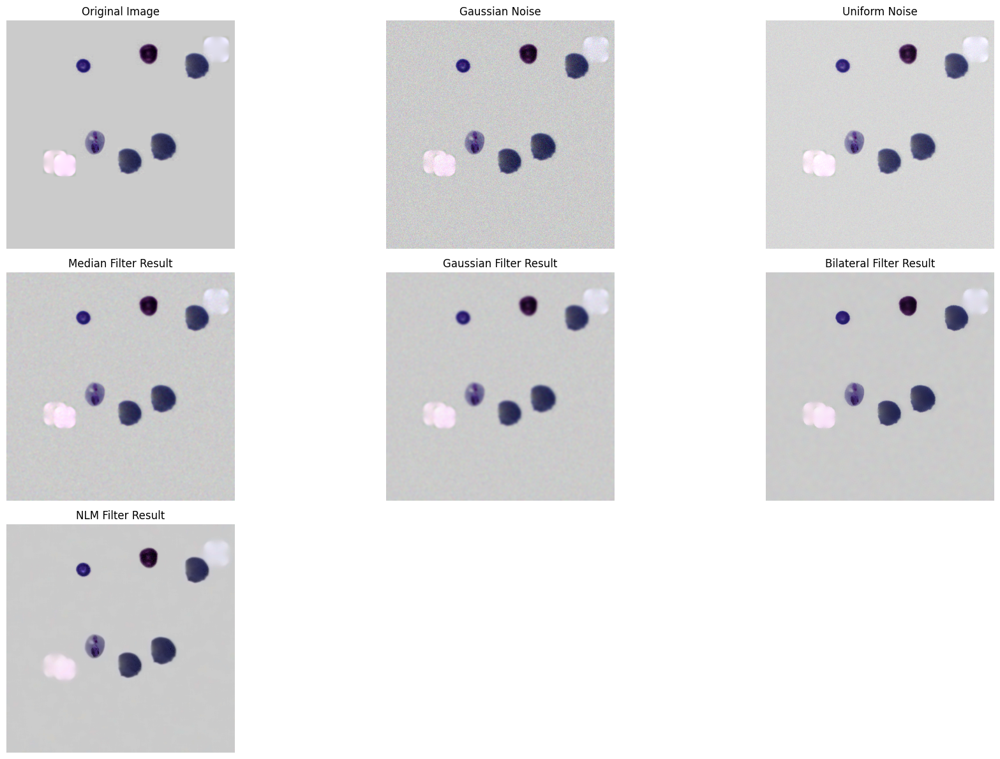


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0011 | 13.17 | 0.9198
Gaussian Blur        | 0.0004 | 8.23 | 0.9737
Bilateral Filter     | 0.0057 | 7.46 | 0.9369
Non-local Means      | 0.1440 | 5.07 | 0.9775


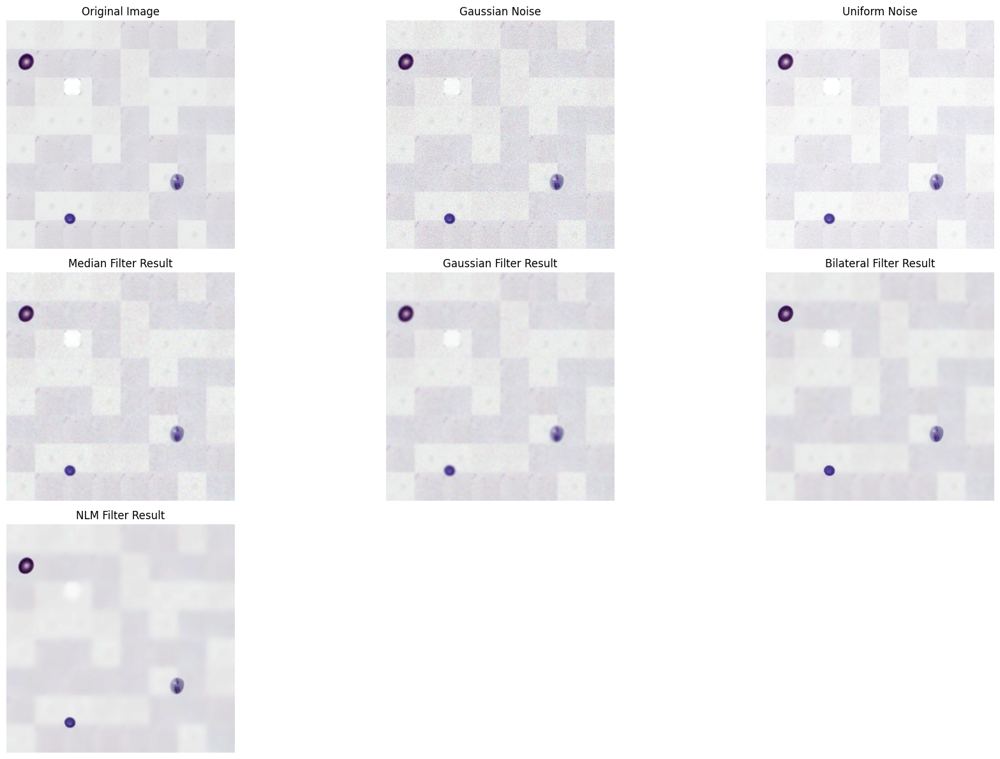


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0014 | 14.46 | 0.9025
Gaussian Blur        | 0.0006 | 8.44 | 0.9569
Bilateral Filter     | 0.0055 | 9.00 | 0.9244
Non-local Means      | 0.1480 | 9.71 | 0.9512


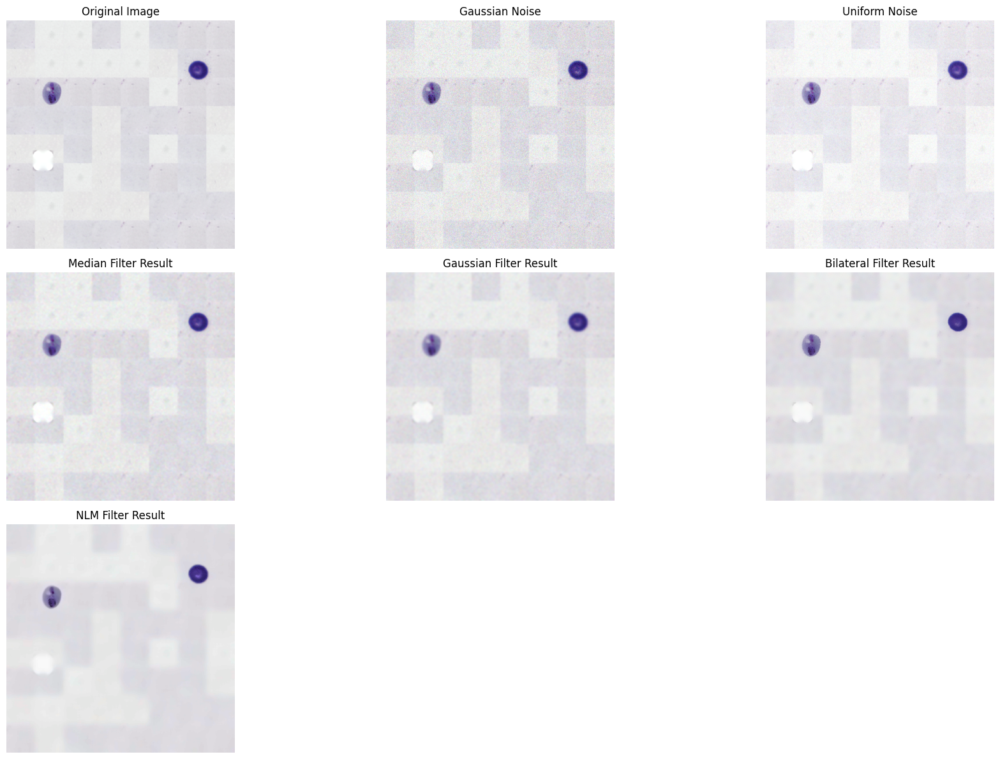


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0011 | 14.24 | 0.9027
Gaussian Blur        | 0.0004 | 8.32 | 0.9571
Bilateral Filter     | 0.0065 | 8.98 | 0.9237
Non-local Means      | 0.1704 | 9.32 | 0.9508


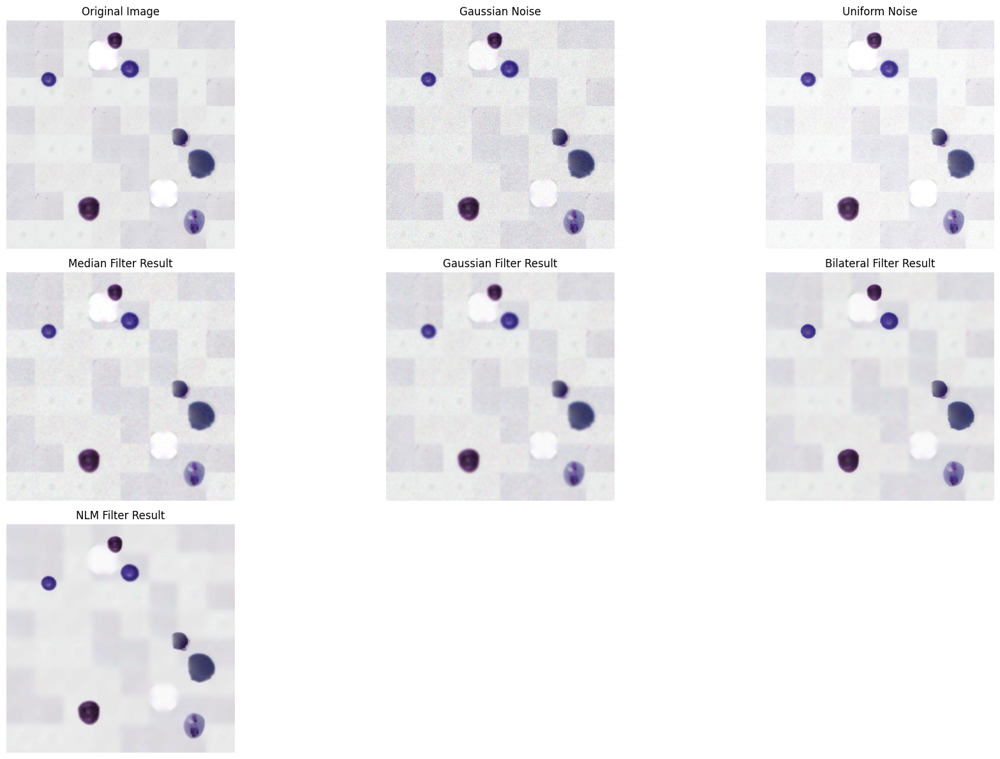


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0011 | 15.40 | 0.9000
Gaussian Blur        | 0.0005 | 11.05 | 0.9517
Bilateral Filter     | 0.0052 | 11.02 | 0.9214
Non-local Means      | 0.1691 | 12.12 | 0.9451


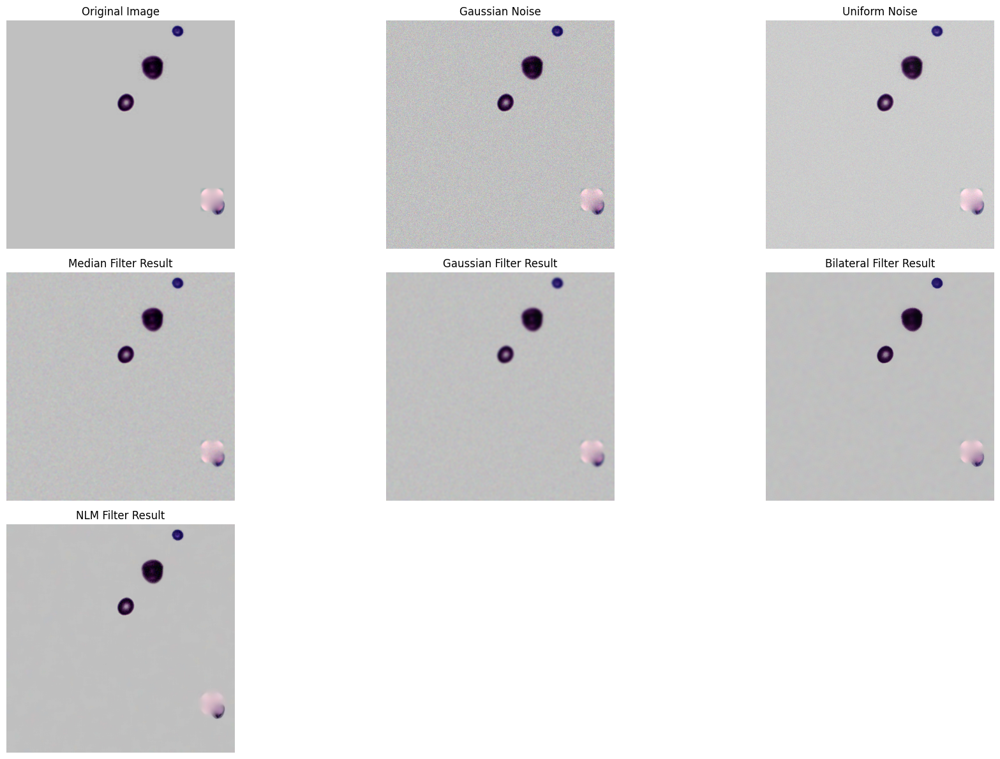


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0011 | 12.17 | 0.9239
Gaussian Blur        | 0.0004 | 6.46 | 0.9783
Bilateral Filter     | 0.0054 | 5.99 | 0.9407
Non-local Means      | 0.1683 | 2.83 | 0.9835


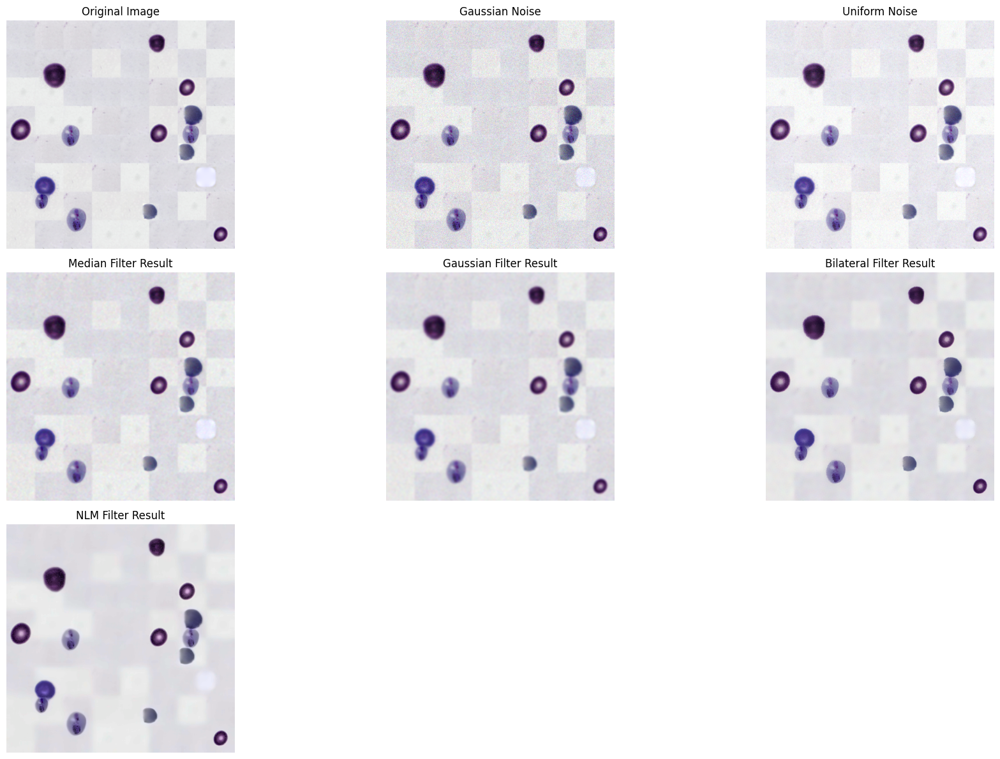


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0010 | 16.85 | 0.8941
Gaussian Blur        | 0.0003 | 12.92 | 0.9415
Bilateral Filter     | 0.0055 | 12.28 | 0.9130
Non-local Means      | 0.1674 | 13.38 | 0.9356


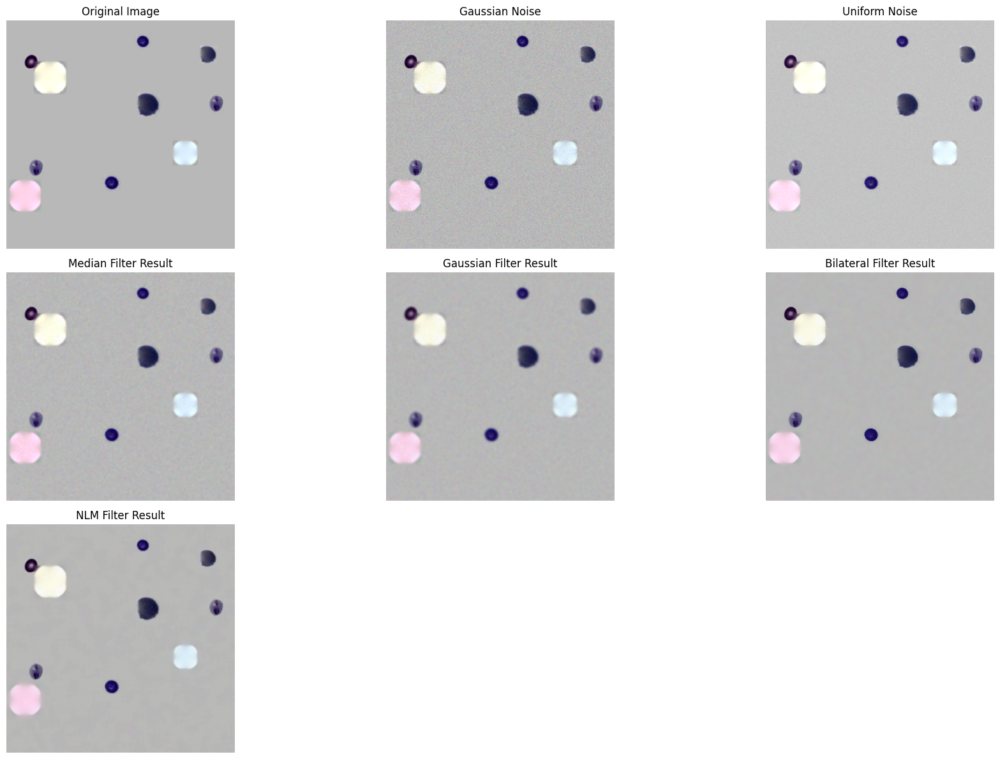


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0011 | 12.91 | 0.9218
Gaussian Blur        | 0.0003 | 8.50 | 0.9740
Bilateral Filter     | 0.0053 | 7.55 | 0.9387
Non-local Means      | 0.1686 | 6.01 | 0.9752


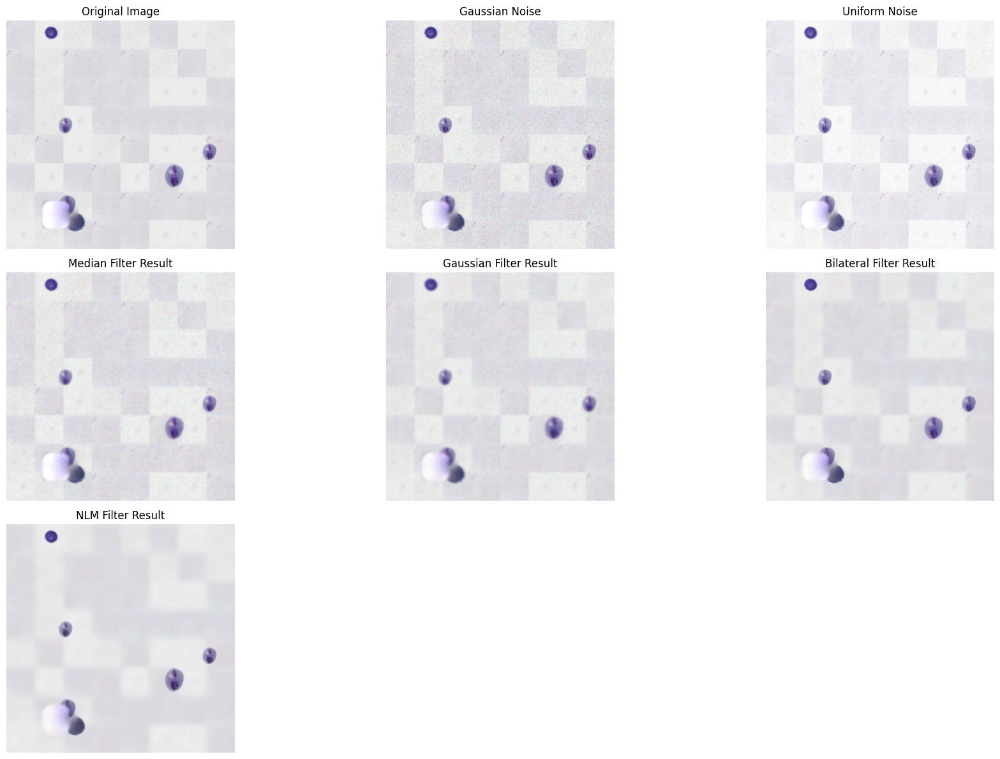


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0012 | 14.93 | 0.9006
Gaussian Blur        | 0.0006 | 9.28 | 0.9537
Bilateral Filter     | 0.0052 | 9.68 | 0.9218
Non-local Means      | 0.1698 | 10.69 | 0.9480


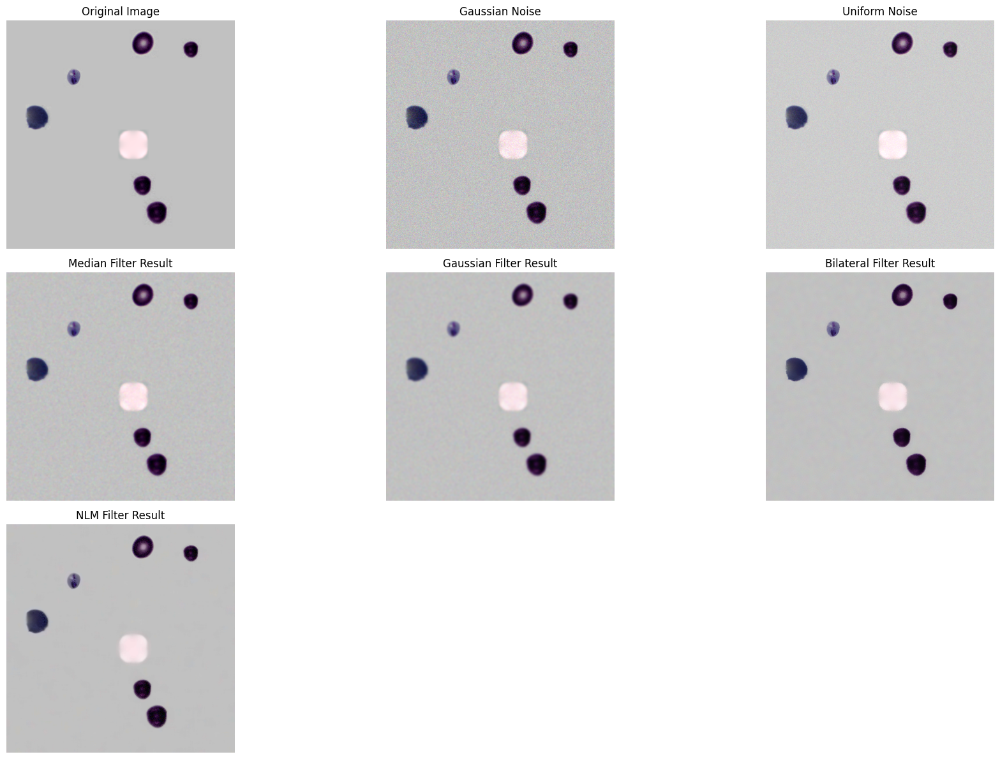


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0011 | 12.75 | 0.9206
Gaussian Blur        | 0.0006 | 7.89 | 0.9731
Bilateral Filter     | 0.0059 | 7.10 | 0.9363
Non-local Means      | 0.1669 | 3.70 | 0.9798


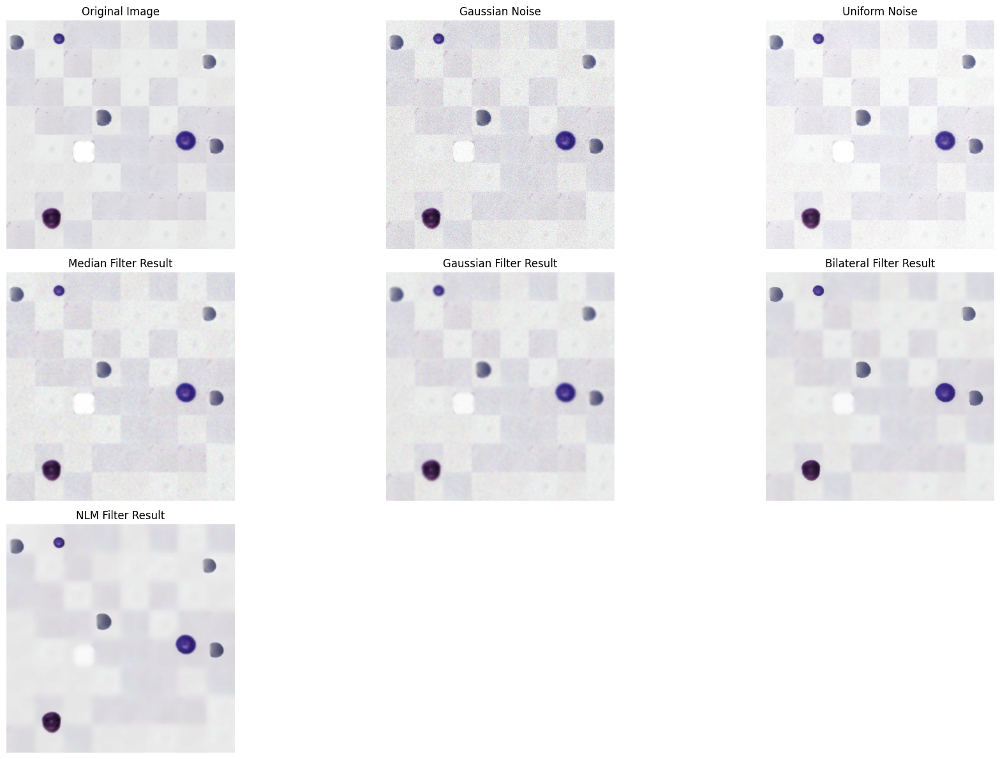


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0089 | 14.88 | 0.9014
Gaussian Blur        | 0.0003 | 9.71 | 0.9538
Bilateral Filter     | 0.0057 | 9.84 | 0.9227
Non-local Means      | 0.1688 | 10.78 | 0.9475


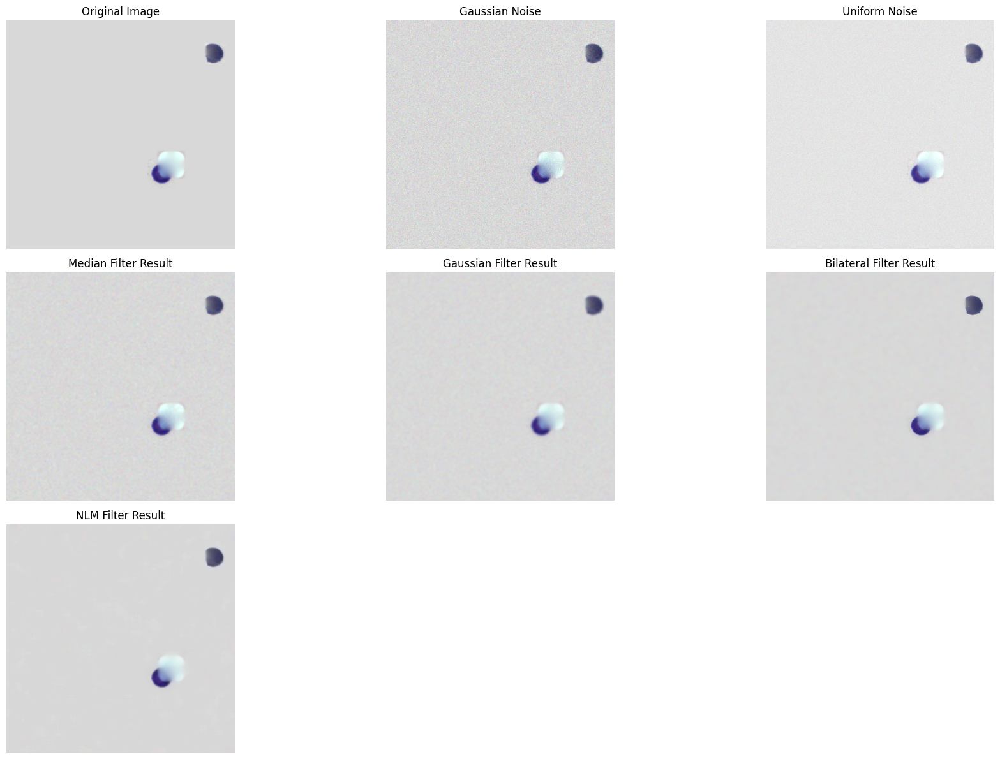


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0076 | 11.83 | 0.9256
Gaussian Blur        | 0.0003 | 5.59 | 0.9827
Bilateral Filter     | 0.0058 | 5.42 | 0.9435
Non-local Means      | 0.1692 | 2.52 | 0.9892


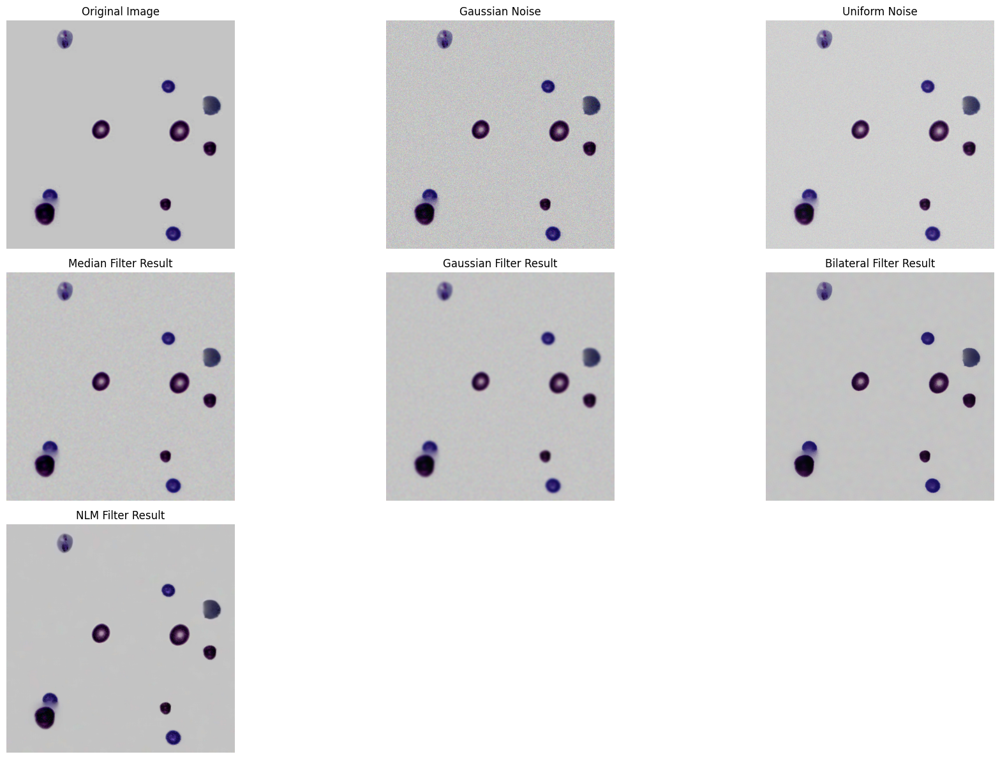


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0059 | 13.39 | 0.9184
Gaussian Blur        | 0.0007 | 8.83 | 0.9682
Bilateral Filter     | 0.0056 | 7.65 | 0.9331
Non-local Means      | 0.1753 | 4.65 | 0.9746


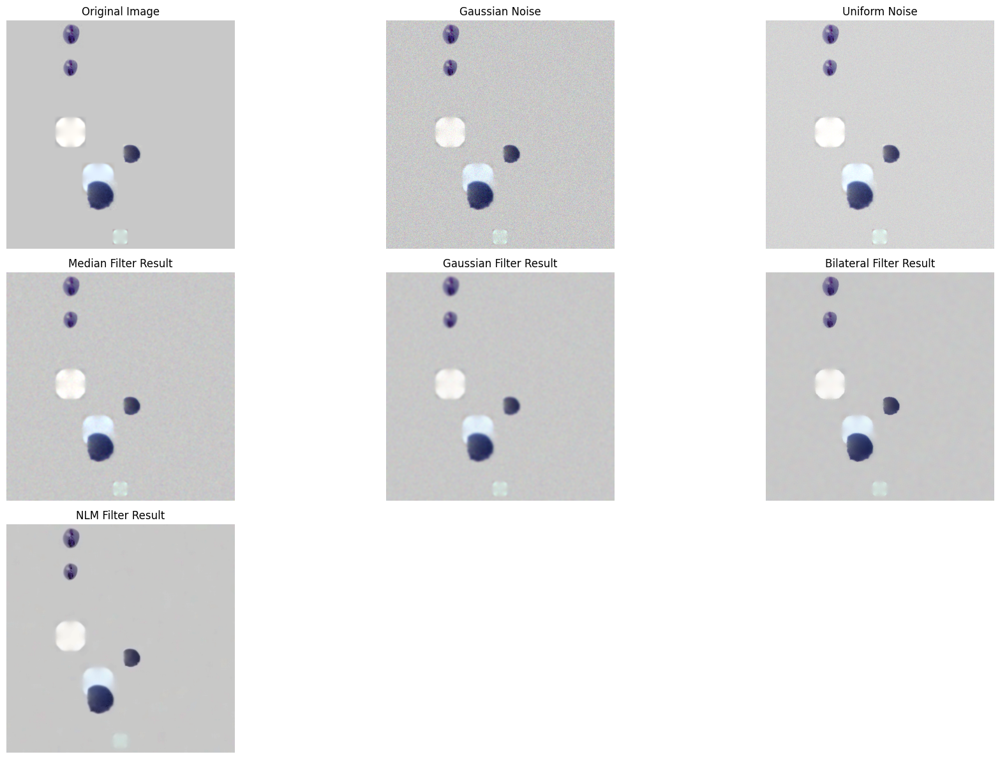


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0030 | 12.56 | 0.9221
Gaussian Blur        | 0.0004 | 7.06 | 0.9780
Bilateral Filter     | 0.0054 | 6.60 | 0.9407
Non-local Means      | 0.1697 | 3.50 | 0.9874


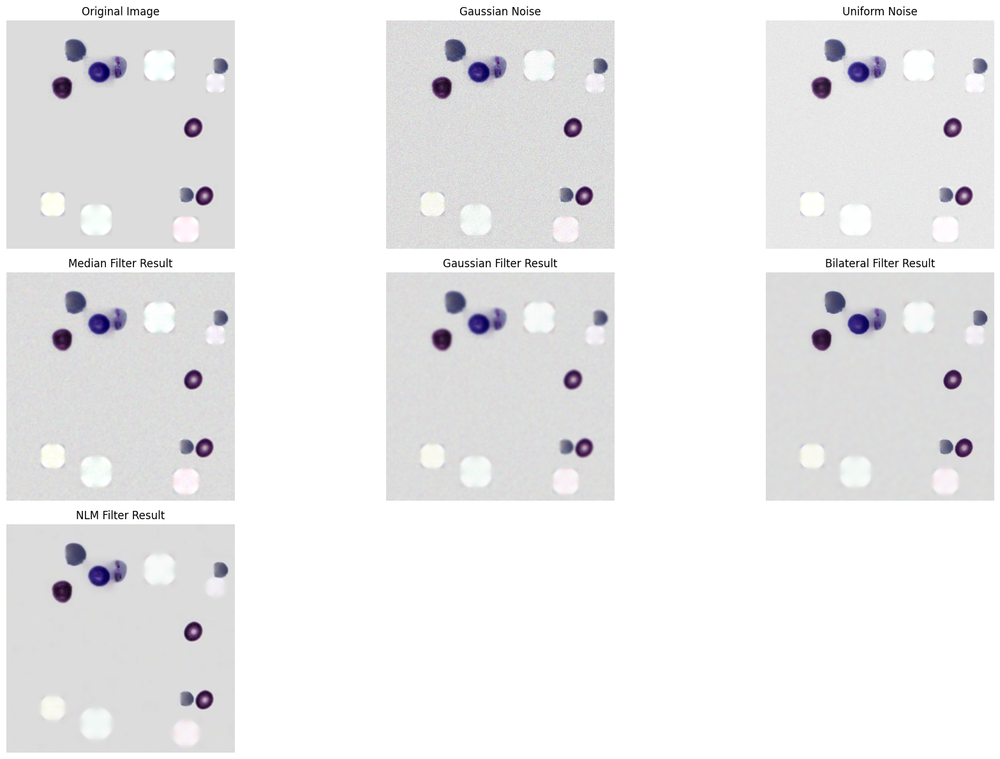


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0011 | 13.68 | 0.9189
Gaussian Blur        | 0.0005 | 10.14 | 0.9704
Bilateral Filter     | 0.0054 | 9.37 | 0.9367
Non-local Means      | 0.1738 | 7.09 | 0.9764


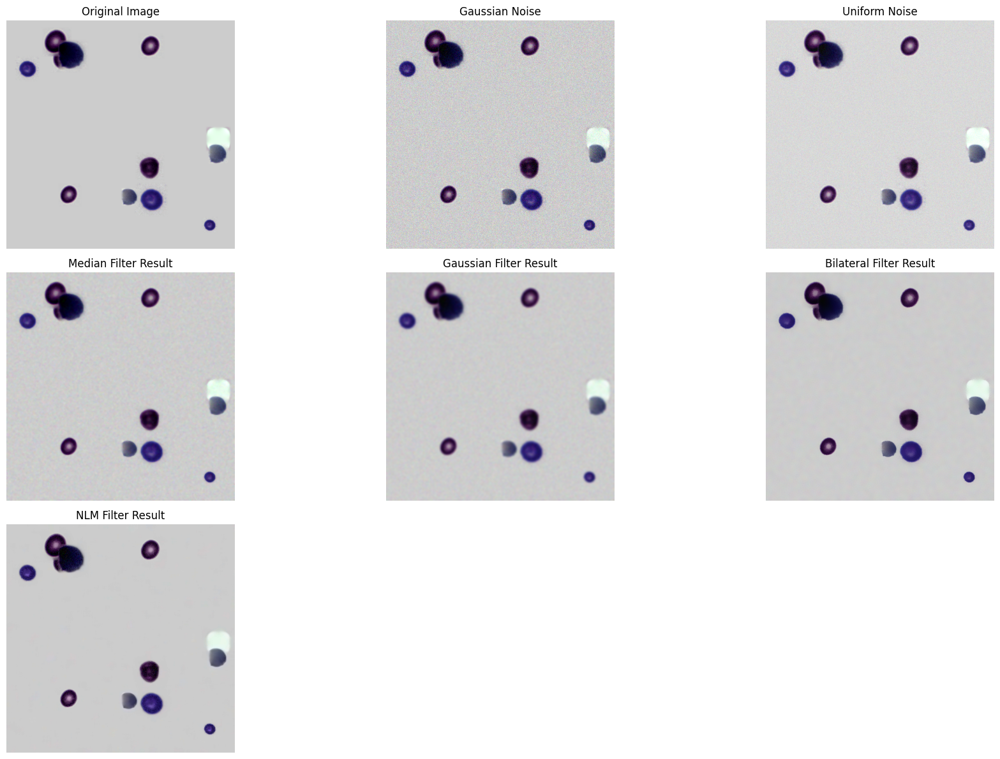


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0024 | 13.82 | 0.9167
Gaussian Blur        | 0.0004 | 9.67 | 0.9657
Bilateral Filter     | 0.0062 | 8.55 | 0.9297
Non-local Means      | 0.1758 | 5.16 | 0.9699


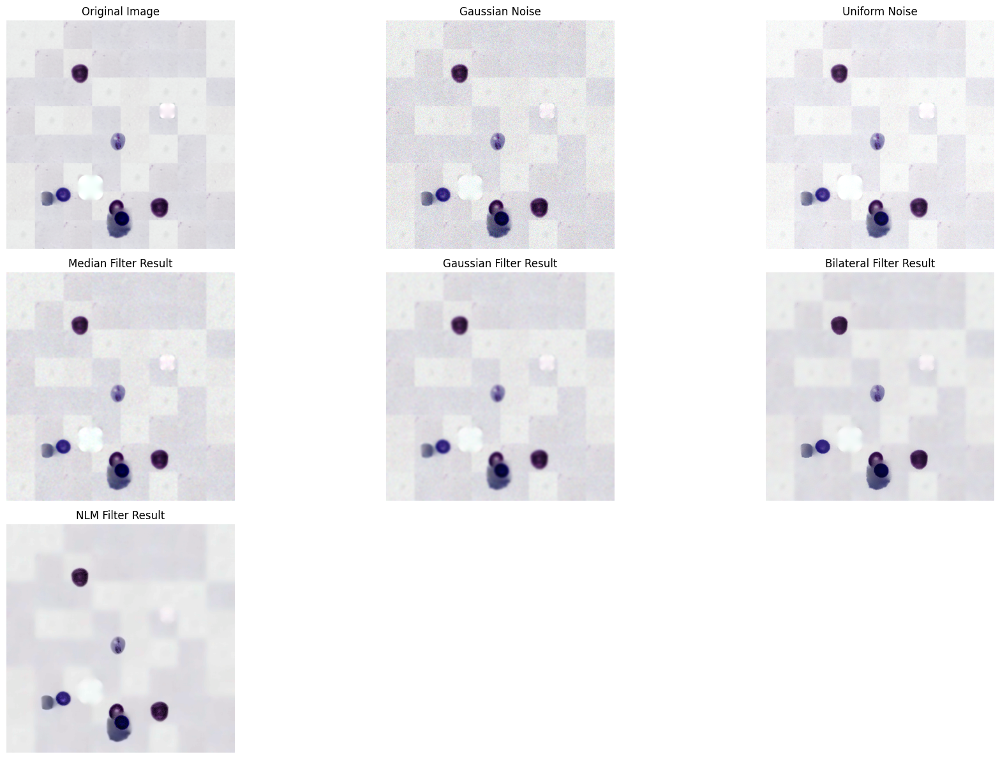


Performance Metrics:
Method               | Time (s) | MSE      | SSIM  
Median Filter        | 0.0011 | 15.04 | 0.9009
Gaussian Blur        | 0.0004 | 10.18 | 0.9513
Bilateral Filter     | 0.0062 | 10.34 | 0.9200
Non-local Means      | 0.1696 | 11.39 | 0.9432


In [4]:
def benchmark_denoising(noisy_img, clean_img):
    results = []
    
    # Медианный фильтр
    start = time.perf_counter()
    denoised = cv2.medianBlur(noisy_img, 5)
    results.append((
        "Median Filter",
        time.perf_counter() - start,
        RestorationMetrics.calculate_mse(clean_img, denoised),
        RestorationMetrics.calculate_ssim(clean_img, denoised)
    ))
    
    # Gaussian
    start = time.perf_counter()
    denoised = cv2.GaussianBlur(noisy_img, (9,9), 2)
    results.append((
        "Gaussian Blur",
        time.perf_counter() - start,
        RestorationMetrics.calculate_mse(clean_img, denoised),
        RestorationMetrics.calculate_ssim(clean_img, denoised)
    ))
    
    # Bilateral
    start = time.perf_counter()
    denoised = cv2.bilateralFilter(noisy_img, 15, 60, 60)
    results.append((
        "Bilateral Filter",
        time.perf_counter() - start,
        RestorationMetrics.calculate_mse(clean_img, denoised),
        RestorationMetrics.calculate_ssim(clean_img, denoised)
    ))
    
    # NLM
    start = time.perf_counter()
    denoised = cv2.fastNlMeansDenoisingColored(noisy_img, None, 10, 10, 7, 21)
    results.append((
        "Non-local Means",
        time.perf_counter() - start,
        RestorationMetrics.calculate_mse(clean_img, denoised),
        RestorationMetrics.calculate_ssim(clean_img, denoised)
    ))
    
    return results

def visualize_results(images, metrics):
    plt.figure(figsize=(18, 12))
    titles = [
        'Original Image', 
        'Gaussian Noise', 
        'Uniform Noise',
        'Median Filter Result', 
        'Gaussian Filter Result',
        'Bilateral Filter Result', 
        'NLM Filter Result'
    ]
    
    for idx, (title, img) in enumerate(zip(titles, images)):
        plt.subplot(3, 3, idx+1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(title)
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    print("\nPerformance Metrics:")
    print(f"{'Method':<20} | {'Time (s)':<8} | {'MSE':<8} | {'SSIM':<6}")
    for name, t, m, s in metrics:
        print(f"{name:<20} | {t:.4f} | {m:.2f} | {s:.4f}")

# Основной цикл обработки
generator = BloodCellGenerator()
processor = NoiseProcessor()

for i in range(NUM_IMAGES):
    clean = generator.generate_sample()
    
    # Генерация шумов
    gaussian_noise = processor.apply_gaussian_noise(clean)
    uniform_noise = processor.apply_uniform_noise(clean)
    
    # Применение фильтров
    gauss_metrics = benchmark_denoising(gaussian_noise, clean)
    uniform_metrics = benchmark_denoising(uniform_noise, clean)
    
    # Визуализация
    denoised_images = [
        clean,
        gaussian_noise,
        uniform_noise,
        cv2.medianBlur(gaussian_noise, 5),
        cv2.GaussianBlur(gaussian_noise, (9,9), 2),
        cv2.bilateralFilter(gaussian_noise, 15, 60, 60),
        cv2.fastNlMeansDenoisingColored(gaussian_noise, None, 10, 10, 7, 21)
    ]
    
    visualize_results(denoised_images, gauss_metrics)
    
    # Сохранение результатов
    cv2.imwrite(str(Path(OUTPUT_DIR) / f"clean_{i:03d}.png"), clean)
    cv2.imwrite(str(Path(OUTPUT_DIR) / f"gauss_noise_{i:03d}.png"), gaussian_noise)
    cv2.imwrite(str(Path(OUTPUT_DIR) / f"uniform_noise_{i:03d}.png"), uniform_noise)